In [1]:
import numpy as np
import xarray as xr
import pandas as pd
from matplotlib import pyplot as plt
import cartopy
import cartopy.crs as ccrs
import scipy as sc
import glob
import os
from scipy.stats import linregress

from sklearn.linear_model import Ridge
#from sklearn.linear_model import RidgeCV
import sklearn
from sklearn.linear_model import LinearRegression 

xr.set_options(display_style='html')
%matplotlib inline
%config InlineBackend.figure_format = 'retina' 



In [2]:
model_list=['CESM2',
 'MRI-ESM2-0',
 'CNRM-CM6-1',
 'MIROC6',
 'IPSL-CM6A-LR',
 'HadGEM3-GC31-LL',
 'CanESM5',
 'TaiESM1'];



root_path='/data/cristi/a/kchoo3/FluxesProcessing/pre-processed/annual/' 

In [41]:
#testing
#fname_tas=glob.glob(root_path+'*_'+'CNRM-CM6-1'+'_'+'amip'+'*.nc')
fname_tas=glob.glob(root_path+'*'+'_*_'+'CNRM-CM6-1'+'_'+'amip_'+'*.nc')
print(fname_tas)
# load data
ds=xr.open_mfdataset(fname_tas)

#ds=ds.isel(time=range(0,150))
ds

['/data/cristi/a/kchoo3/FluxesProcessing/pre-processed/annual/tas-annual_Amon_CNRM-CM6-1_amip_r1i1p1f2_gr_1979-2014.nc', '/data/cristi/a/kchoo3/FluxesProcessing/pre-processed/annual/toa-annual_Amon_CNRM-CM6-1_amip_r1i1p1f2_gr_1979-2014.nc', '/data/cristi/a/kchoo3/FluxesProcessing/pre-processed/annual/cre-annual_Amon_CNRM-CM6-1_amip_r1i1p1f2_gr_1979-2014.nc']


<xarray.Dataset> Size: 14MB
Dimensions:  (lat: 128, lon: 256, time: 36)
Coordinates:
  * lat      (lat) float64 1kB -88.93 -87.54 -86.14 -84.74 ... 86.14 87.54 88.93
  * lon      (lon) float64 2kB 0.0 1.406 2.812 4.219 ... 354.4 355.8 357.2 358.6
  * time     (time) datetime64[ns] 288B 1979-01-01 1980-01-01 ... 2014-01-01
    height   float64 8B ...
Data variables:
    cre      (time, lat, lon) float32 5MB dask.array<chunksize=(36, 128, 256), meta=np.ndarray>
    tas      (time, lat, lon) float32 5MB dask.array<chunksize=(36, 128, 256), meta=np.ndarray>
    toa      (time, lat, lon) float32 5MB dask.array<chunksize=(36, 128, 256), meta=np.ndarray>
Attributes: (12/52)
    CMIP6_CV_version:      cv=6.2.3.0-7-g2019642
    Conventions:           CF-1.7 CMIP-6.2
    EXPID:                 CNRM-CM6-1_amip_r1i1p1f2_amip_AGCM_1979_v2
    activity_id:           CMIP
    arpege_minor_version:  6.3.2
    branch_method:         no parent
    ...                    ...
    title:                 CNRM-CM6-1 model output prepared for CMIP6 / CMIP ...
    tracking_id:           hdl:21.14100/1b22201a-41b0-499d-bfb1-a69efb47944c
    variable_id:           rsdt
    variant_label:         r1i1p1f2
    xios_commit:           1442-shuffle
    status:                2019-11-07;created;by nhn2@columbia.edu

# Data Processing & Verification
- take anomalies, 
- clean-up time indices
- select the same time-itnerval for all models
- compute global means

## Processing

In [3]:
exp = ['amip-piForcing','piControl','abrupt-4xCO2', 'amip']

ds_list = list()

ds_amipf = []
ds_ctrl = []
ds_co2 = []
ds_amip = []


for model_ind in range(len(model_list)):    
    model=model_list[model_ind]    
    print(model)
    print('')
    for experiment in exp:
        # filenames for this particular model and experiment. there shold be three files, for tas, toa,cre. 

        fexp = (f'{experiment}_')
        fname_tas=glob.glob(root_path+'*_'+model+'_'+fexp+'*.nc')

        # load data
        ds=xr.open_mfdataset(fname_tas)
        
        # do a little cleaning up. 
        if experiment =='amip-piForcing':
            print(experiment)
            # let's ensure all models have the same time-interval (1870-2014). This selects the interval that all of them have. 
            ds=ds.sel(time=slice('1870','2014'))

            #compute anomalies relative to the first thirty years (1870-1900).
            ds=ds-ds.sel(time=slice('1870','1900')).mean('time')

            #assign a new time-index
            new_time_index=pd.date_range(start='1870-01-01',freq='YE',periods=145)
            ds=ds.assign(time=new_time_index)
        elif experiment =='amip':
            print(experiment)
            ds=ds.sel(time=slice('1980','2014'))

            ds=ds-ds.sel(time=slice('1980','2000')).mean('time')

            #assign a new time-index
            new_time_index=pd.date_range(start='1980-01-01',freq='YE',periods=35)
            ds=ds.assign(time=new_time_index)
        elif experiment =='piControl':
            print(experiment)
            #let's only select 500 years of control simulation       
            ds=ds.isel(time=range(0,500))
            
            #compute anomalies
            ds=ds-ds.mean('time')
            
            #assign a new time-index
            new_time_index=pd.date_range(start='1700-01-01',freq='YE',periods=len(ds.time))
            ds=ds.assign(time=new_time_index)

        elif experiment =='abrupt-4xCO2':
            print(experiment)     
            ds=ds.isel(time=range(0,150))
            
            #compute anomalies
            ds=ds-ds.mean('time')
            
            #assign a new time-index
            new_time_index=pd.date_range(start='2000-01-01',freq='YE',periods=len(ds.time))
            ds=ds.assign(time=new_time_index)
        
        #create weights for averaging 
        weights = np.cos(np.deg2rad(ds.lat))
        weights.name = "weights"
        
        #compute global averages for TOA, CRE, TAS
        ds=ds.assign(TOA=ds.toa.weighted(weights).mean(("lon", "lat")))
        ds=ds.assign(CRE=ds.cre.weighted(weights).mean(("lon", "lat")))
        ds=ds.assign(TAS=ds.tas.weighted(weights).mean(("lon", "lat")))

        #drop spatial information for toa and cre    
        #ds=ds.drop('toa');
        #ds=ds.drop('cre');
        
        try:
            ds=ds.drop_vars('lat_bnds');
            ds=ds.drop_vars('lon_bnds');
        except:
            print('')
            
        if experiment =='amip-piForcing':
            ds_amipf.append(ds)
        elif experiment =='piControl':
            ds_ctrl.append(ds)
        elif experiment =='abrupt-4xCO2':
            ds_co2.append(ds)
        elif experiment =='amip':
            ds_amip.append(ds)
        print("done")

CESM2

amip-piForcing

done
piControl

done
abrupt-4xCO2
done
amip

done
MRI-ESM2-0

amip-piForcing

done
piControl
done
abrupt-4xCO2

done
amip
done
CNRM-CM6-1

amip-piForcing

done
piControl


/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/coding/times.py:995: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/indexing.py:630: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  array = array.get_duck_array()
/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/indexing.py:500: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(self.get_duck_array(), dtype=dtype)
/data/keeling/a/kchoo3/anaconda3/envs/myenv/


done
abrupt-4xCO2

done
amip

done
MIROC6

amip-piForcing

done


/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/coding/times.py:995: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/indexing.py:630: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  array = array.get_duck_array()
/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/indexing.py:500: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(self.get_duck_array(), dtype=dtype)
/data/keeling/a/kchoo3/anaconda3/envs/myenv/

piControl
done
abrupt-4xCO2


/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/coding/times.py:995: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/indexing.py:630: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  array = array.get_duck_array()
/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/indexing.py:500: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(self.get_duck_array(), dtype=dtype)
/data/keeling/a/kchoo3/anaconda3/envs/myenv/

done
amip
done
IPSL-CM6A-LR

amip-piForcing

done


/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/coding/times.py:995: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/indexing.py:630: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  array = array.get_duck_array()
/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/indexing.py:500: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(self.get_duck_array(), dtype=dtype)
/data/keeling/a/kchoo3/anaconda3/envs/myenv/

piControl

done
abrupt-4xCO2

done
amip

done
HadGEM3-GC31-LL

amip-piForcing

done
piControl
done
abrupt-4xCO2
done
amip
done
CanESM5

amip-piForcing

done
piControl

done
abrupt-4xCO2
done
amip
done
TaiESM1

amip-piForcing

done
piControl

done
abrupt-4xCO2
done
amip

done


## Make some plots to verify our processing

In [4]:
# dsfig is used to select what experiment to take a look at 
# Each variable in the list represents all the datasets in: amipf=amip-piforcing, ctrl=control, co2=abrupt co2, amip=amip
# keep it this way for now. Non configurable
dsfig = [ds_amipf, ds_ctrl, ds_co2, ds_amip]

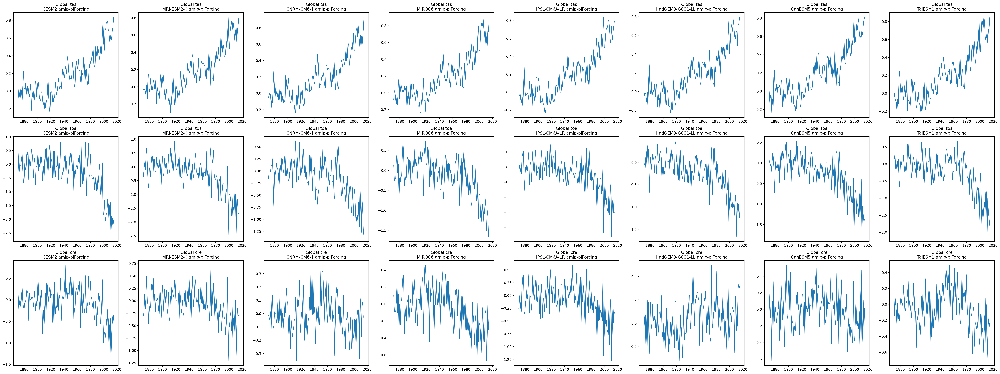

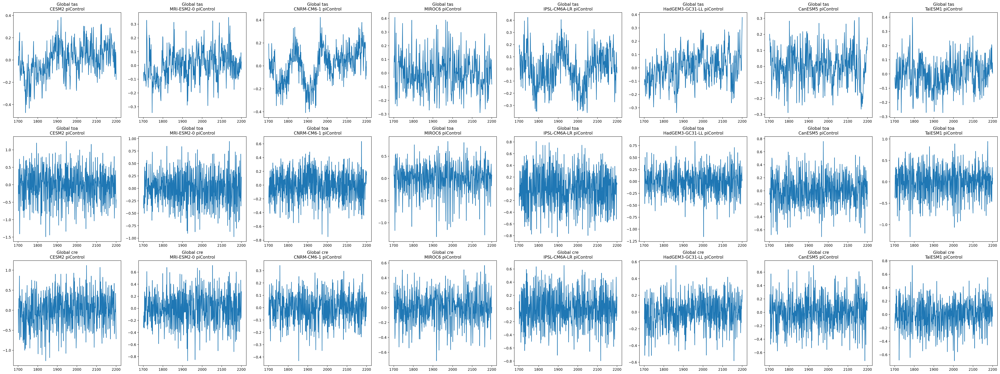

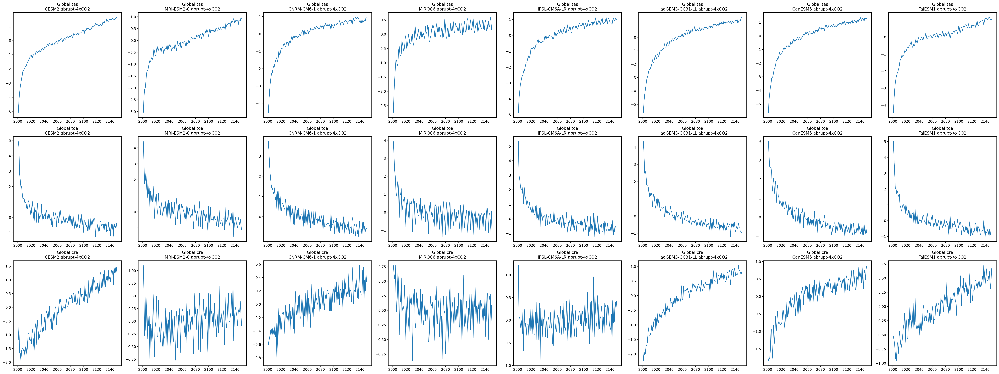

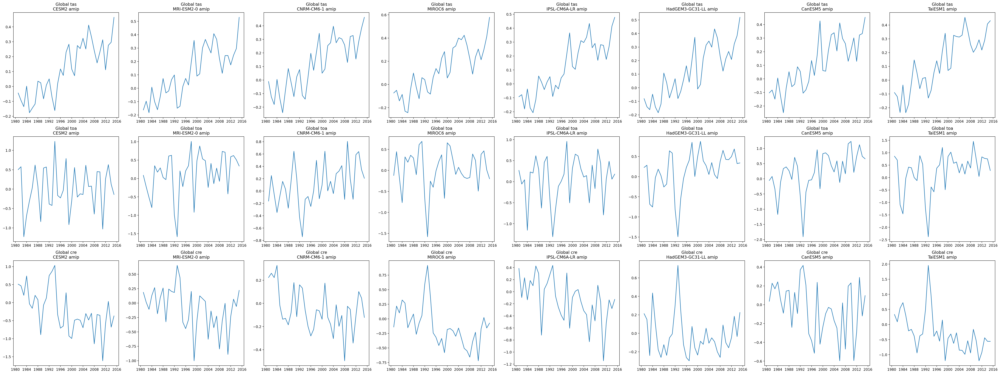

In [5]:
for n in range(len(dsfig)):
    plt.figure(figsize=[40,15])
    for mod in range(len(model_list)):
        plt.subplot(3,8,mod+1)
        plt.title(f'Global tas\n{model_list[mod]} {exp[n]}')
        plt.plot(dsfig[n][mod].time,dsfig[n][mod].TAS, label="tas");

        plt.subplot(3,8,mod+9)
        plt.title(f'Global toa\n{model_list[mod]} {exp[n]}')
        plt.plot(dsfig[n][mod].time,dsfig[n][mod].TOA, label="toa");

        plt.subplot(3,8,mod+17)
        plt.title(f'Global cre\n{model_list[mod]} {exp[n]}')
        plt.plot(dsfig[n][mod].time,dsfig[n][mod].CRE, label="cre");
    plt.tight_layout()
    plt.savefig(f"{exp[n]}_graph.png")
    #plt.close()

# Regression  (amip-piForcing vs amip-piForcing)

In [5]:
## Configuration
# ind_train is used for the timeframe to train. This is only for amip-piforcing. The default (125, 145) is the last 25 years of the model.
ind_train = np.arange(125, 145)

ds_trained_amipf = [[0 for _ in range(len(model_list))] for _ in range(2)]
for mod in range(len(model_list)):
    for n in range(2):
        ds_stack=dsfig[n][mod].stack(z=('lat','lon'))
        
        #stack the data such that there is a single location dimension (that indexes over both lat and lon)
        ds_fig_stack=dsfig[n][mod].stack(z=('lat','lon'))
        
        #define the X and y (the predictor and the predictand / the input and the output)
        # when you fit the data you need a matrix of predictors X and a vector of targets y. 
        X_fig=ds_fig_stack.tas
        y_fig=ds_fig_stack.TOA
        
        # regress and train the model
        if n == 0: #amip-piforcing
            X_train=X_fig.isel(time=ind_train)
            y_train=y_fig.isel(time=ind_train)
        elif n == 1: #control
            X_train=X_fig
            y_train=y_fig

        reg_model = sklearn.linear_model.RidgeCV().fit(X_train,y_train)
        
        # make a prediction with the model
        try:
            yhat_fig= reg_model.predict(X_fig)
            
            #save the coefficients.
            beta=reg_model.coef_
            
            #assign
            ds_fig_stack=ds_fig_stack.assign(beta=('z',beta))
            ds_fig_stack=ds_fig_stack.assign(TOAhat=('time',yhat_fig))
            
            #unstack
            if n == 0:
                ds_trained_amipf[0][mod]=ds_fig_stack.unstack()
            elif n == 1:
                dsfig[n][mod]=ds_fig_stack.unstack()
        except ValueError:
            pass
            print("ValueError. Please check the pre-processed data")

In [6]:
# model trained on piControl (1) predicting amip-piForcing (0)

for mod in range(len(model_list)):
    ds_fig0_stack=dsfig[0][mod].stack(z=('lat','lon'))
    ds_fig1_stack=dsfig[1][mod].stack(z=('lat','lon'))

    X_fig0=ds_fig0_stack.tas
    
    X_fig=ds_fig1_stack.tas
    y_fig=ds_fig1_stack.TOA

    X_train=X_fig
    y_train=y_fig

    reg_model = sklearn.linear_model.RidgeCV().fit(X_train,y_train)

    yhat_fig= reg_model.predict(X_fig0)

    beta=reg_model.coef_

    ds_fig0_stack=ds_fig0_stack.assign(beta=('z',beta))
    ds_fig0_stack=ds_fig0_stack.assign(TOAhat=('time',yhat_fig))

    ds_trained_amipf[n][mod]=ds_fig0_stack.unstack()

In [7]:
# model trained on amip-piforcing/piControl (0,1) predicting abrupt4xCO2 (2)
ds_trained_co2 = [[0 for _ in range(len(model_list))] for _ in range(2)]
for n in range(2): #this is used for the model trained (that is, amip-piforcing and piControl)
    for mod in range(len(model_list)):
        ds_fig0_stack=dsfig[2][mod].stack(z=('lat','lon'))
        ds_fig1_stack=dsfig[n][mod].stack(z=('lat','lon'))
    
        X_fig0=ds_fig0_stack.tas
        
        X_fig=ds_fig1_stack.tas
        y_fig=ds_fig1_stack.TOA
    
        X_train=X_fig
        y_train=y_fig
    
        reg_model = sklearn.linear_model.RidgeCV().fit(X_train,y_train)
    
        yhat_fig= reg_model.predict(X_fig0)
    
        beta=reg_model.coef_
    
        ds_fig0_stack=ds_fig0_stack.assign(beta=('z',beta))
        ds_fig0_stack=ds_fig0_stack.assign(TOAhat=('time',yhat_fig))
    
        ds_trained_co2[n][mod]=ds_fig0_stack.unstack()

## Test: Ignore this section

In [8]:
n = 0

# ds_stack=dsfig[n][0].stack(z=('lat','lon'))

#stack the data such that there is a single location dimension (that indexes over both lat and lon)
ds_fig_stack=dsfig[n][0].stack(z=('lat','lon'))


#define the X and y (the predictor and the predictand / the input and the output)
# when you fit the data you need a matrix of predictors X and a vector of targets y. 
X_fig=ds_fig_stack.tas
y_fig=ds_fig_stack.TOA


# regress

ind_train = None
#define a training interval
if n == 3:
    ind_train=np.arange(25, 35)
elif n == 0:
    ind_train=np.arange(125, 145)
elif n == 1:
    ind_train=np.arange(0, 50)
elif n == 2:
    ind_train=np.arange(0, 50)

# train the model
if ind_train is not None:
    X_train=X_fig.isel(time=ind_train)
    y_train=y_fig.isel(time=ind_train)
else:
    X_train=X_fig
    y_train=y_fig   

reg_model = sklearn.linear_model.RidgeCV().fit(X_train,y_train)

# make a prediction with the model
try:
    yhat_fig= reg_model.predict(X_fig)
    
    #save the coefficients.
    beta=reg_model.coef_
    
    #assign
    ds_fig_stack=ds_fig_stack.assign(beta=('z',beta))
    ds_fig_stack=ds_fig_stack.assign(TOAhat=('time',yhat_fig))
    
    #unstack
    test_ds=ds_fig_stack.unstack()
    test_ds
except ValueError:
    pass

In [9]:
#stack the data such that there is a single location dimension (that indexes over both lat and lon)
ds_amip_stack=ds_amip[0].stack(z=('lat','lon'))


#define the X and y (the predictor and the predictand / the input and the output)
# when you fit the data you need a matrix of predictors X and a vector of targets y. 
X_amip=ds_amip_stack.tas
y_amip=ds_amip_stack.TOA


# regress

#define a training interval
ind_train=np.arange(25, 35)

# train the model
X_train=X_amip.isel(time=ind_train)
y_train=y_amip.isel(time=ind_train)

reg_model = sklearn.linear_model.RidgeCV().fit(X_train,y_train)

# make a prediction with the model
yhat_amip= reg_model.predict(X_amip)

#save the coefficients.
beta=reg_model.coef_

#assign
ds_amip_stack=ds_amip_stack.assign(beta=('z',beta))
ds_amip_stack=ds_amip_stack.assign(TOAhat=('time',yhat_amip))

#unstack
ds_amip[0]=ds_amip_stack.unstack()
ds_amip[0]

<xarray.Dataset> Size: 24MB
Dimensions:  (lat: 192, lon: 288, time: 35)
Coordinates:
  * lat      (lat) float64 2kB -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
  * lon      (lon) float64 2kB 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
  * time     (time) datetime64[ns] 280B 1980-12-31 1981-12-31 ... 2014-12-31
Data variables:
    cre      (time, lat, lon) float32 8MB dask.array<chunksize=(35, 192, 288), meta=np.ndarray>
    tas      (time, lat, lon) float32 8MB dask.array<chunksize=(35, 192, 288), meta=np.ndarray>
    toa      (time, lat, lon) float32 8MB dask.array<chunksize=(35, 192, 288), meta=np.ndarray>
    TOA      (time) float64 280B dask.array<chunksize=(35,), meta=np.ndarray>
    CRE      (time) float64 280B dask.array<chunksize=(35,), meta=np.ndarray>
    TAS      (time) float64 280B dask.array<chunksize=(35,), meta=np.ndarray>
    beta     (lat, lon) float64 442kB -4.85e-05 -4.85e-05 ... -2.852e-06
    TOAhat   (time) float64 280B 0.2921 0.5456 0.3472 ... 0.6311 0.1257 -0.1391

# Plots

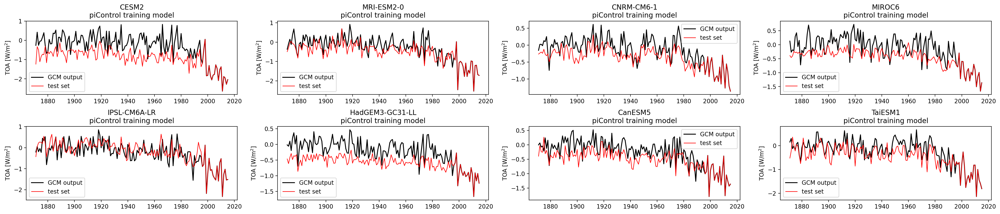

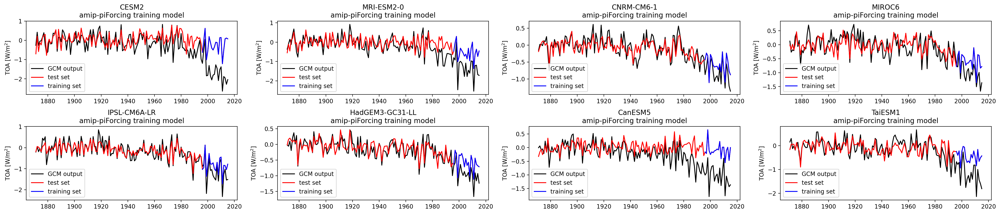

In [8]:
#!!! Check labels
# amip-piForcing
for n in range(2):
    plt.figure(figsize=[24,10])
    for mod in range(len(model_list)):
        plt.subplot(4,4,mod+1)
        plt.plot(ds_trained_amipf[n][mod].time,ds_trained_amipf[n][mod].TOA,'k',label='GCM output')
        if n == 0:
            plt.plot(ds_trained_amipf[n][mod].time,ds_trained_amipf[n][mod].TOAhat,'r',label='test set', linewidth=1)
            plt.title(f'{model_list[mod]}\npiControl training model')
        elif n == 1:
            plt.plot(ds_trained_amipf[n][mod].time,ds_trained_amipf[n][mod].TOAhat,'r',label='test set')
            plt.plot(ds_trained_amipf[n][mod].isel(time=ind_train).time,ds_trained_amipf[n][mod].isel(time=ind_train).TOAhat,'b',label='training set')
            plt.title(f'{model_list[mod]}\namip-piForcing training model')
        plt.ylabel('TOA [W/m$^2$]')
        plt.legend()
    plt.tight_layout()
    plt.savefig(f"{n}_graph.png")

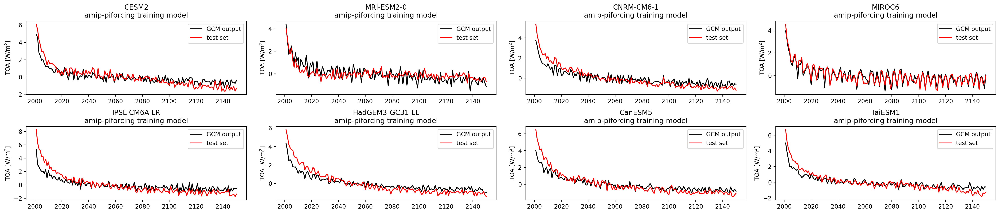

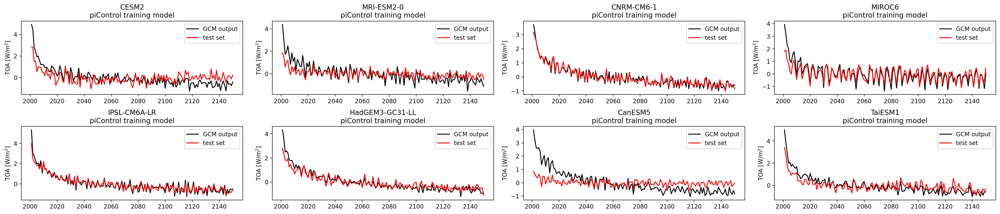

In [9]:
# abrupt co2
for n in range(2):
    plt.figure(figsize=[24,10])
    for mod in range(len(model_list)):
    
        plt.subplot(4,4,mod+1)
        plt.plot(ds_trained_co2[n][mod].time,ds_trained_co2[n][mod].TOA,'k',label='GCM output')
        plt.plot(ds_trained_co2[n][mod].time,ds_trained_co2[n][mod].TOAhat,'r',label='test set')
        #plt.plot(ds_trained_co2[n][mod].isel(time=ind_train).time,ds_trained_co2[n][mod].isel(time=ind_train).TOAhat,'b',label='training set')
        if n == 0:
            plt.title(f'{model_list[mod]}\namip-piforcing training model')
        elif n == 1:
            plt.title(f'{model_list[mod]}\npiControl training model')
        plt.ylabel('TOA [W/m$^2$]')
        plt.legend()
    plt.tight_layout()
    plt.savefig(f"1{n}_graph.png")

<>:9: SyntaxWarning: invalid escape sequence '\p'
<>:9: SyntaxWarning: invalid escape sequence '\p'
/tmp/ipykernel_22563/2593406268.py:9: SyntaxWarning: invalid escape sequence '\p'
  cbar_kwargs={'label':'$\partial \overline{R} / \partial T(x)$','shrink':0.4,'orientation':'horizontal'})


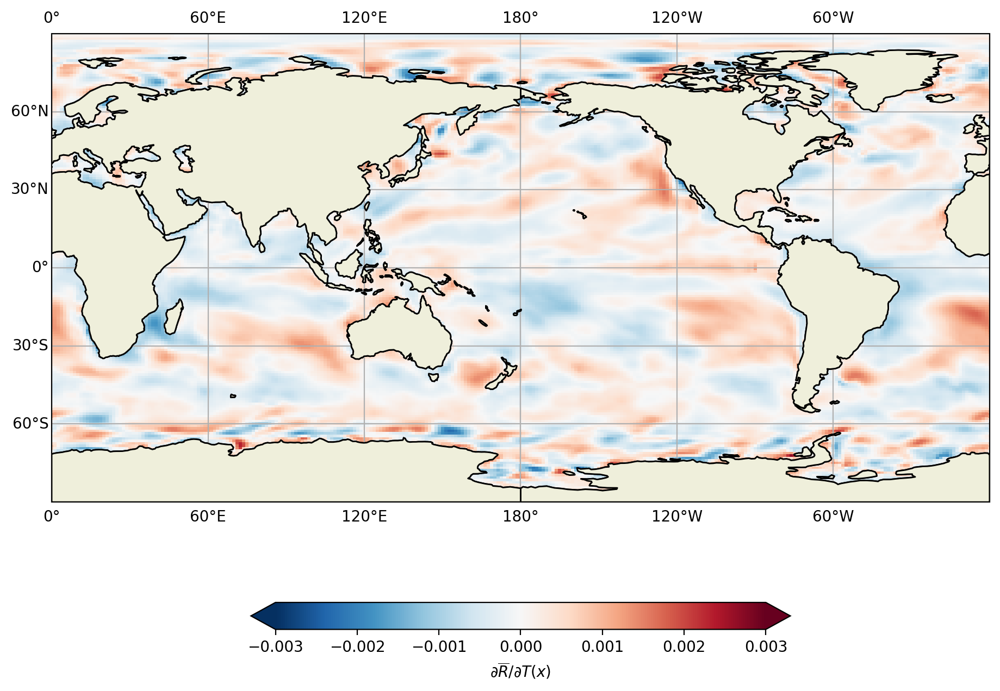

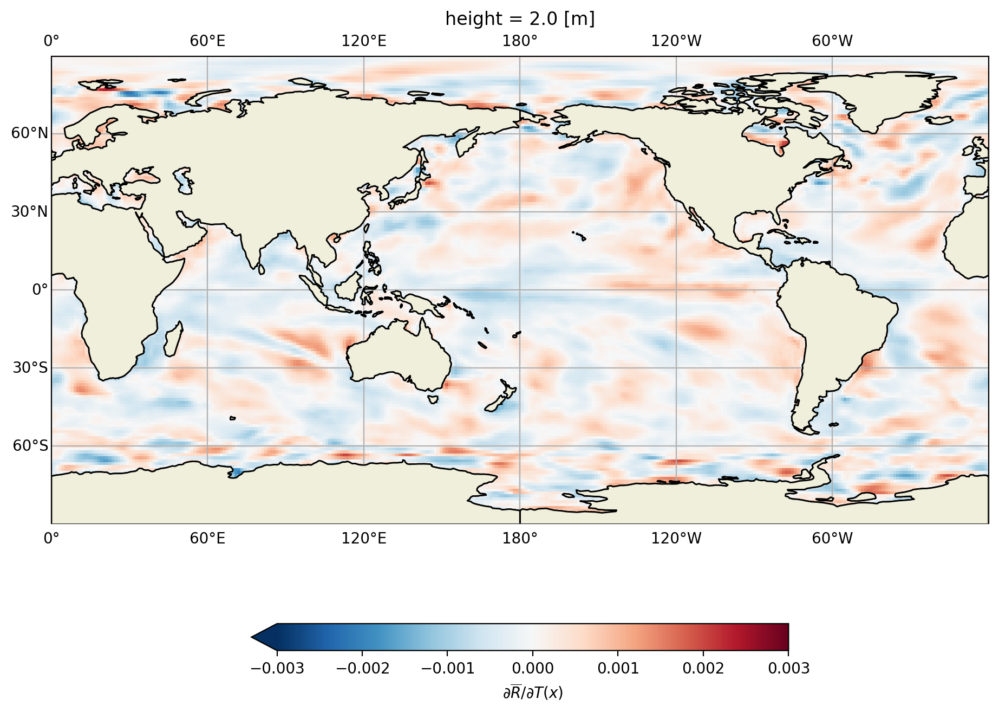

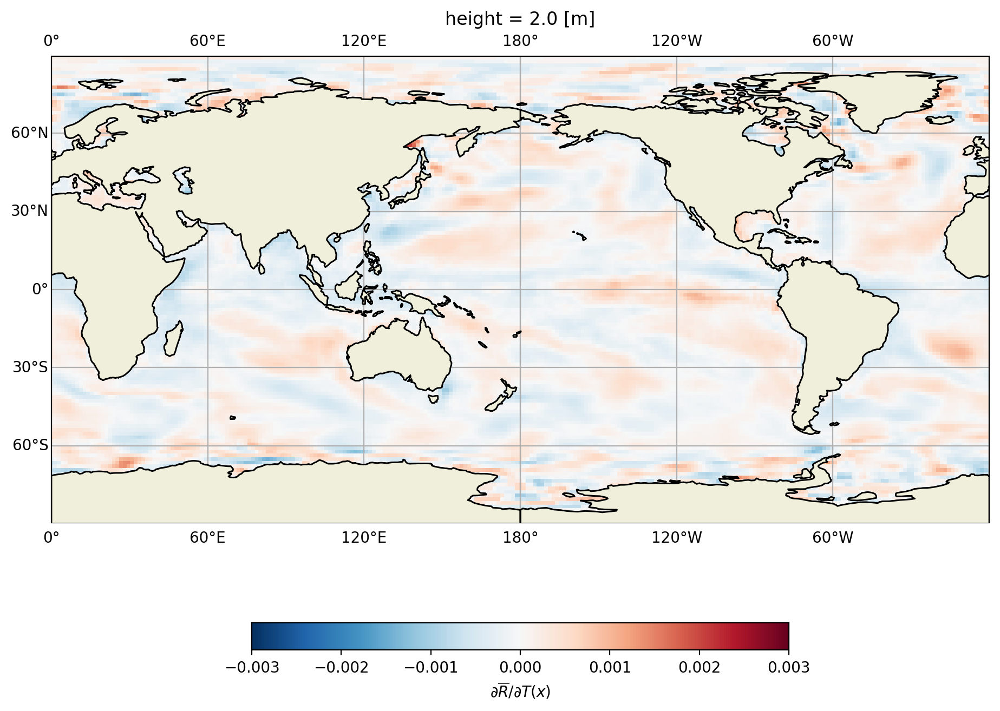

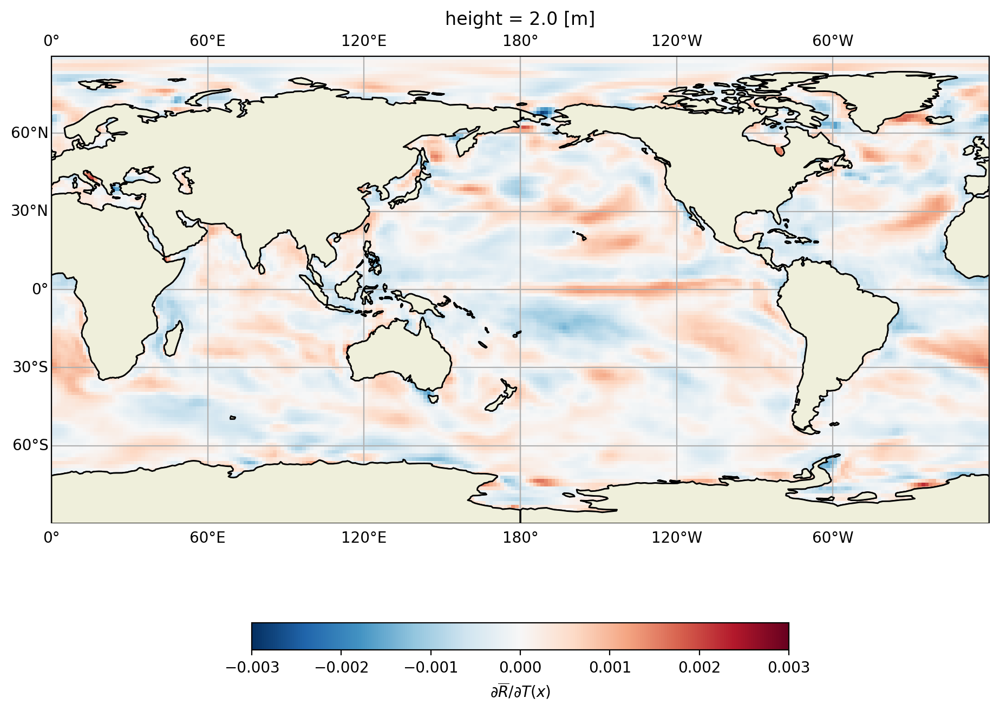

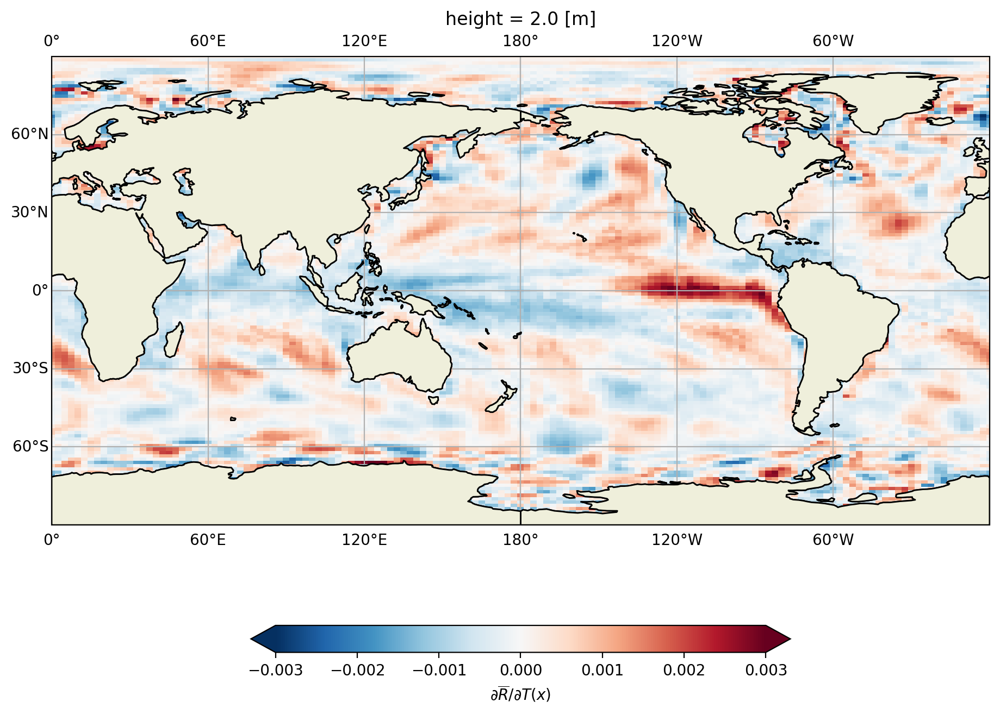

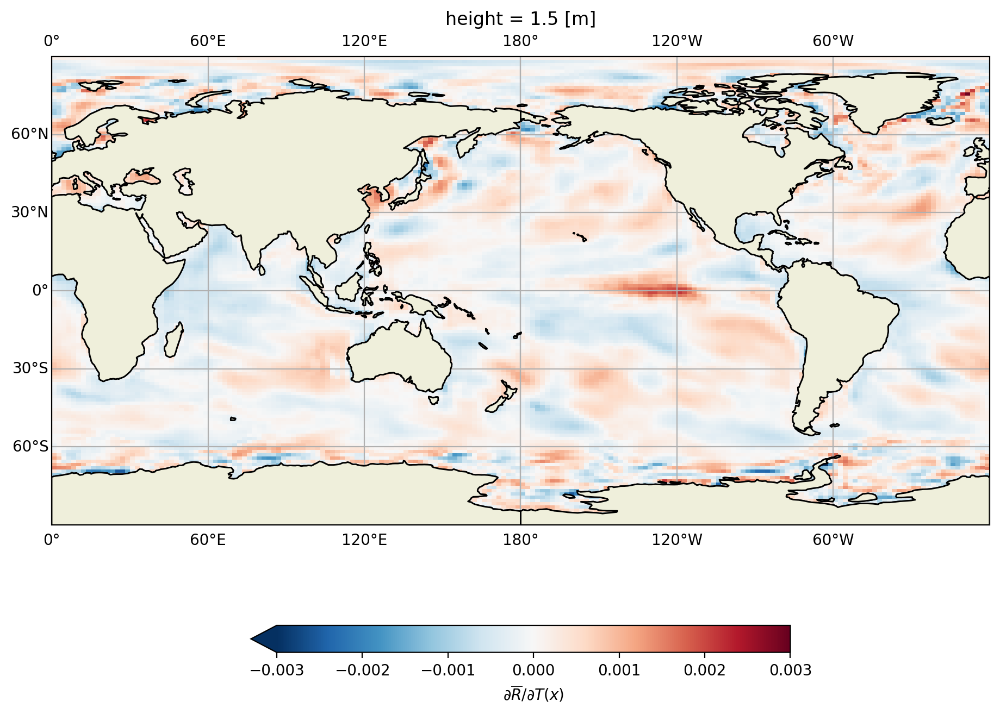

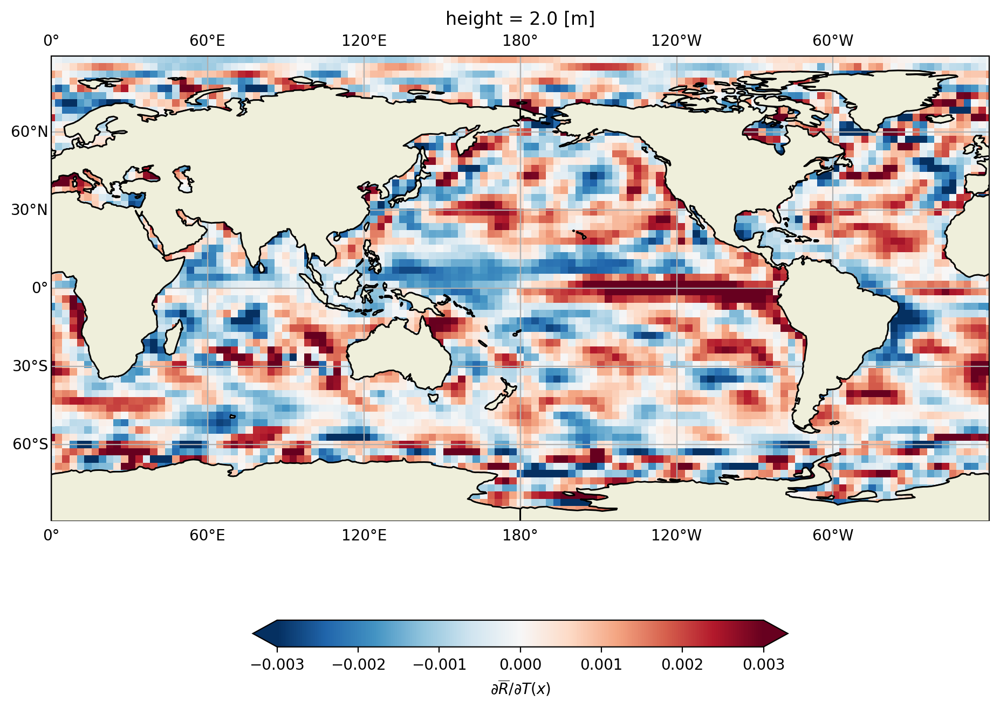

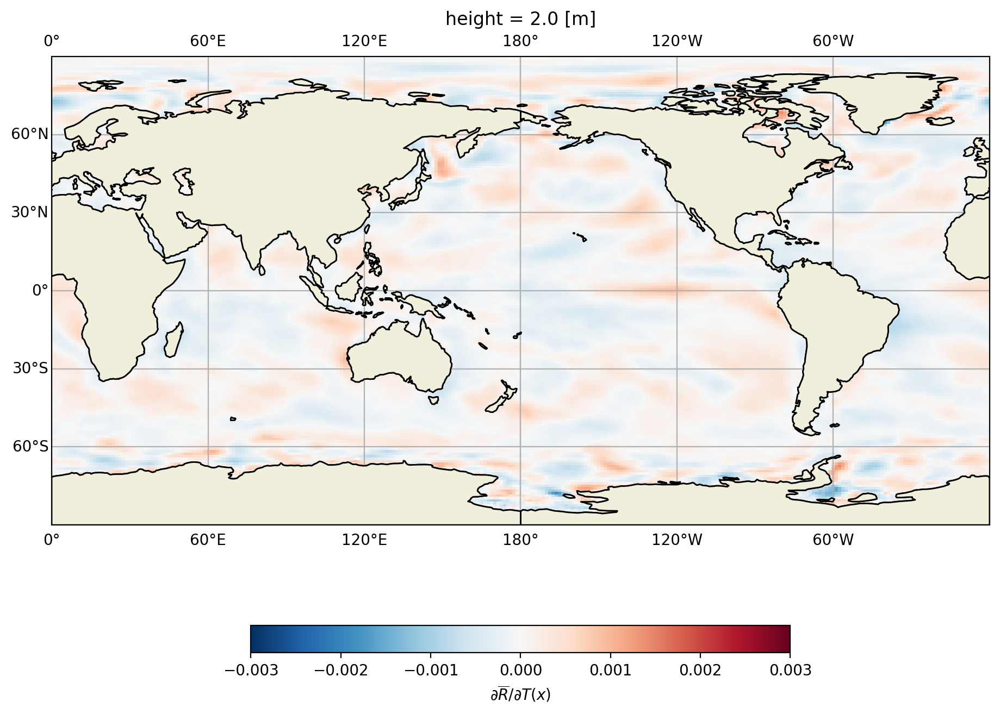

In [17]:
for mod in range(len(model_list)):
    fig=plt.figure(figsize=(16,8))
    ax=plt.axes(projection=ccrs.PlateCarree(central_longitude=180.0))
    ax.coastlines()
    ax.add_feature(cartopy.feature.LAND, zorder=100, edgecolor='k')
    ax.gridlines(draw_labels=True)
    
    ds_trained_amipf[1][mod].beta.plot(ax=ax,transform=ccrs.PlateCarree(),cmap=plt.get_cmap('RdBu').reversed(),vmin=-3E-3,vmax=3E-3,
            cbar_kwargs={'label':'$\partial \overline{R} / \partial T(x)$','shrink':0.4,'orientation':'horizontal'})

# Ignore

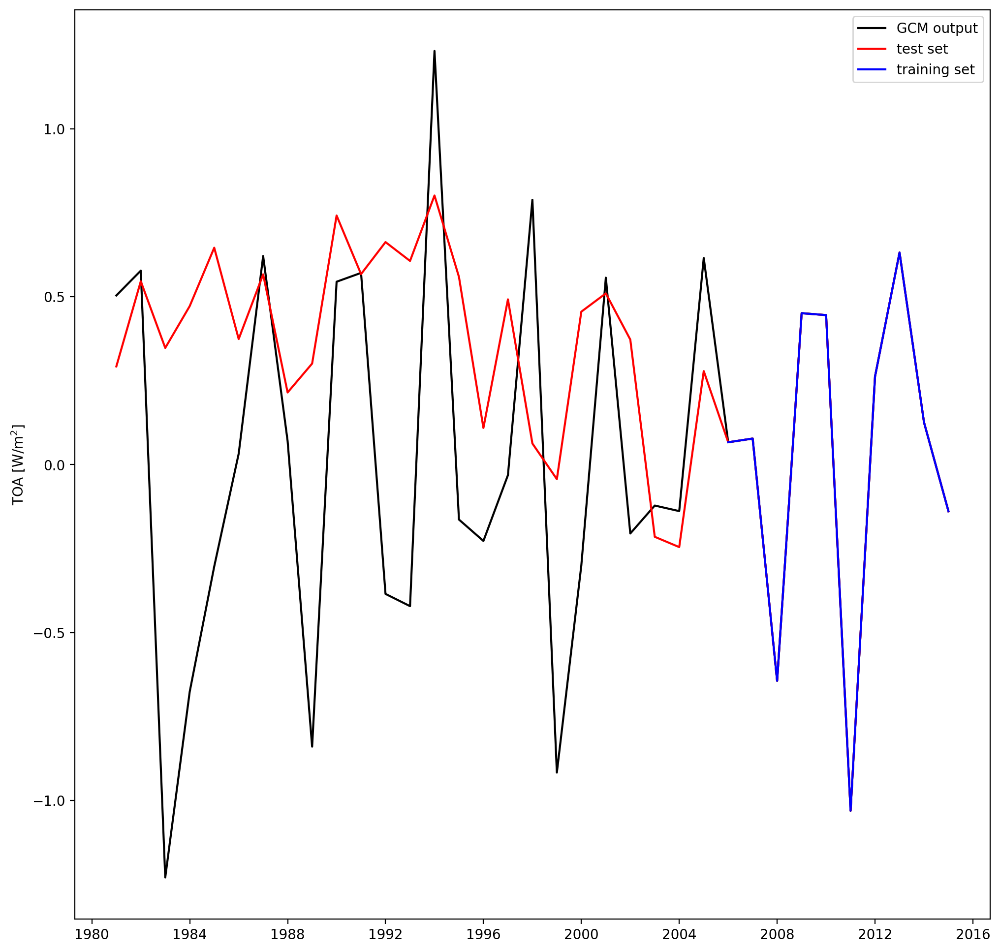

In [37]:
plt.figure(figsize=[12,12])

plt.plot(ds_amip[0].time,ds_amip[0].TOA,'k',label='GCM output')
plt.plot(ds_amip[0].time,ds_amip[0].TOAhat,'r',label='test set')
plt.plot(ds_amip[0].isel(time=ind_train).time,ds_amip[0].isel(time=ind_train).TOAhat,'b',label='training set')

plt.ylabel('TOA [W/m$^2$]')
plt.legend()

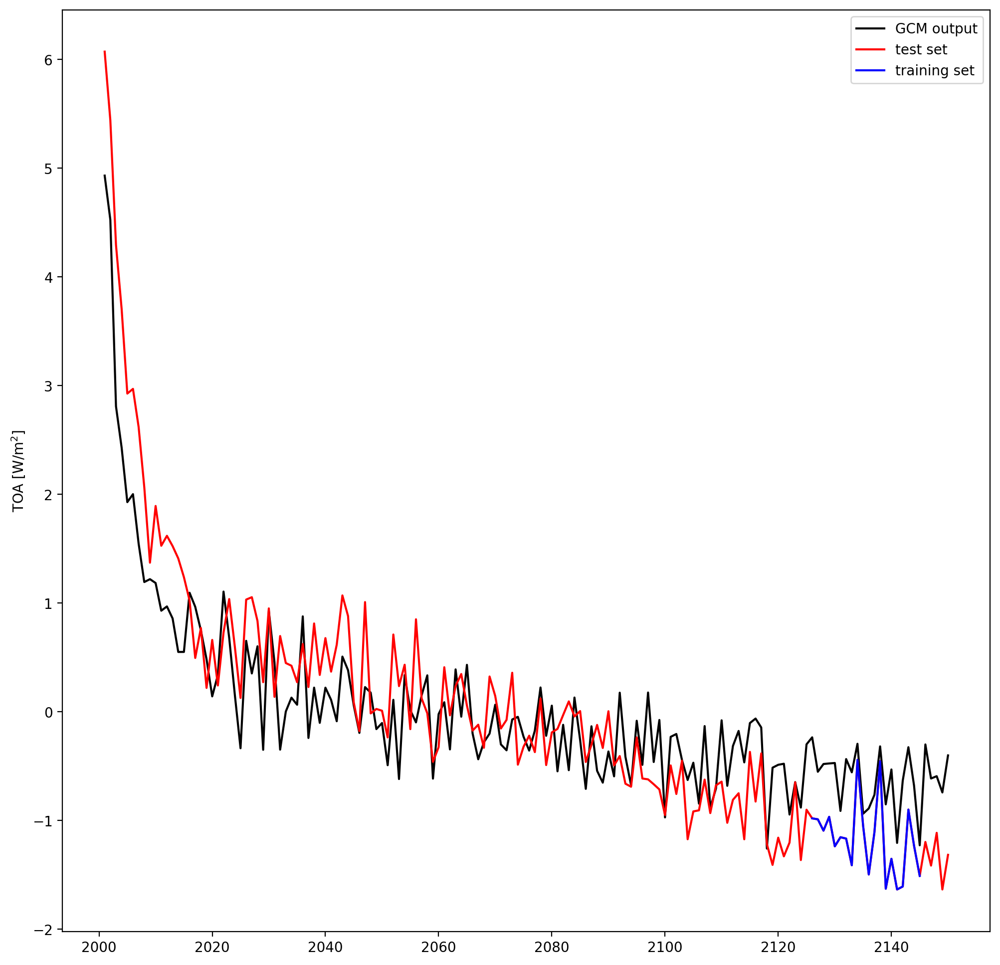

In [12]:
plt.figure(figsize=[12,12])

plt.plot(test_ds.time,test_ds.TOA,'k',label='GCM output')
plt.plot(test_ds.time,test_ds.TOAhat,'r',label='test set')
plt.plot(test_ds.isel(time=ind_train).time,test_ds.isel(time=ind_train).TOAhat,'b',label='training set')

plt.ylabel('TOA [W/m$^2$]')
plt.legend()

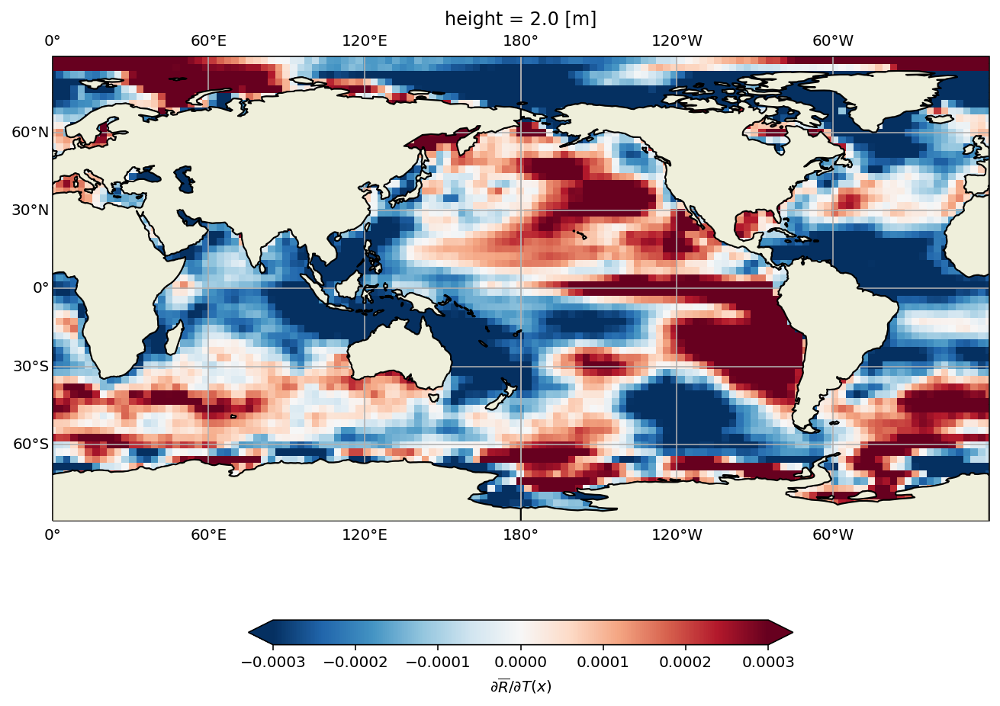

In [295]:
fig=plt.figure(figsize=(16,8))
ax=plt.axes(projection=ccrs.PlateCarree(central_longitude=180.0))
ax.coastlines()
ax.add_feature(cartopy.feature.LAND, zorder=100, edgecolor='k')
ax.gridlines(draw_labels=True)

ds_amip.beta.plot(ax=ax,transform=ccrs.PlateCarree(),cmap=plt.get_cmap('RdBu').reversed(),vmin=-3E-4,vmax=3E-4,
        cbar_kwargs={'label':'$\partial \overline{R} / \partial T(x)$','shrink':0.4,'orientation':'horizontal'})

In [281]:
#stack the data such that there is a single location dimension (that indexes over both lat and lon)
ds_fig_stack=ds_amip.stack(z=('lat','lon'))
ds_ctrl_stack=ds_ctrl.stack(z=('lat','lon'))


#define the X and y (the predictor and the predictand / the input and the output)
# when you fit the data you need a matrix of predictors X and a vector of targets y. 
X_amip=ds_fig_stack.tas
y_amip=ds_fig_stack.TOA

X_ctrl=ds_ctrl_stack.tas
y_ctrl=ds_ctrl_stack.TOA


# regress

# train the model
X_train=X_ctrl
y_train=y_ctrl

reg_model = sklearn.linear_model.RidgeCV().fit(X_train,y_train)

# make a prediction with the model
yhat_amip= reg_model.predict(X_amip)
yhat_ctrl= reg_model.predict(X_ctrl)

#save the coefficients.
beta=reg_model.coef_

#assign
ds_ctrl_stack=ds_ctrl_stack.assign(beta=('z',beta))
ds_fig_stack=ds_fig_stack.assign(TOAhat=('time',yhat_amip))
ds_ctrl_stack=ds_ctrl_stack.assign(TOAhat=('time',yhat_ctrl))

#unstack
ds_amip=ds_fig_stack.unstack()
ds_ctrl=ds_ctrl_stack.unstack()

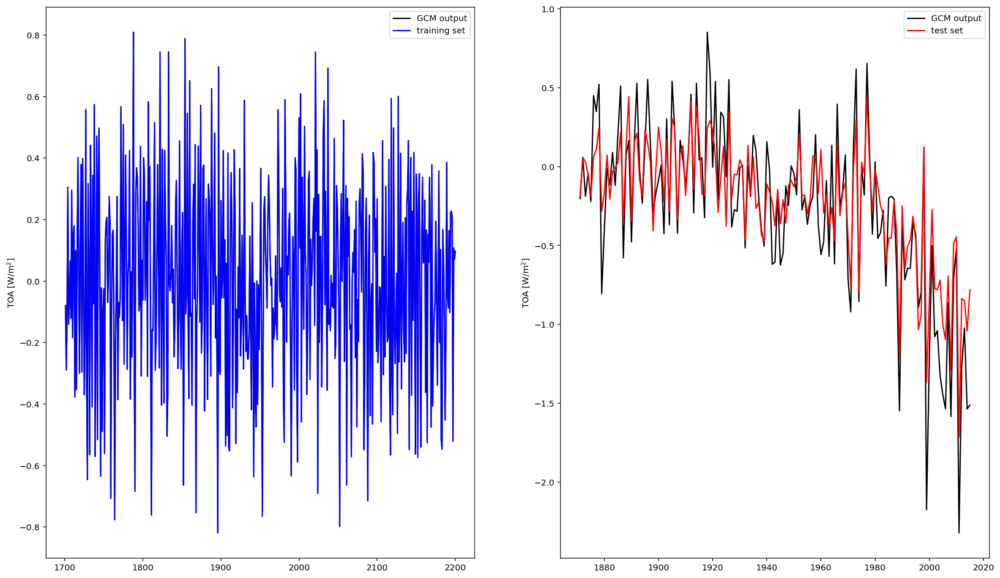

In [283]:
plt.figure(figsize=[20,12])

plt.subplot(1,2,1)
plt.plot(ds_ctrl.time,ds_ctrl.TOA,'k',label='GCM output')
plt.plot(ds_ctrl.time,ds_ctrl.TOAhat,'b',label='training set')
plt.ylabel('TOA [W/m$^2$]')
plt.legend()


plt.subplot(1,2,2)
plt.plot(ds_amip.time,ds_amip.TOA,'k',label='GCM output')
plt.plot(ds_amip.time,ds_amip.TOAhat,'r',label='test set')
plt.ylabel('TOA [W/m$^2$]')
plt.legend()

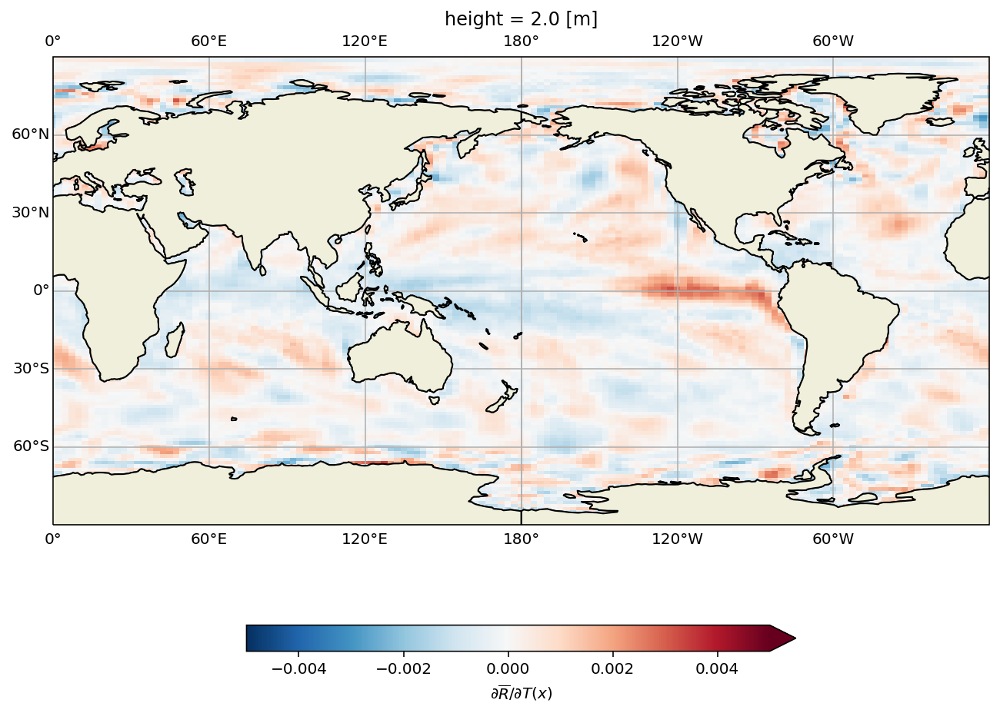

In [288]:
fig=plt.figure(figsize=(16,8))
ax=plt.axes(projection=ccrs.PlateCarree(central_longitude=180.0))
ax.coastlines()
ax.add_feature(cartopy.feature.LAND, zorder=100, edgecolor='k')
ax.gridlines(draw_labels=True)

ds_ctrl.beta.plot(ax=ax,transform=ccrs.PlateCarree(),cmap=plt.get_cmap('RdBu').reversed(),vmin=-5E-3,vmax=5E-3,
        cbar_kwargs={'label':'$\partial \overline{R} / \partial T(x)$','shrink':0.4,'orientation':'horizontal'})

In [136]:

    
ds_list = list()
experiment='abrupt-4xCO2'
for model_ind in range(8):
    model=model_list[model_ind]    
    print(model)
    fname=path+experiment+'_annualanoms_'+model+'.nc'
    ds=xr.open_dataset(fname)

    if experiment=='abrupt-4xCO2':
        ds=ds-ds.isel(time=0)    
        new_time_index=pd.date_range(start='2015-01-01',freq='Y',periods=150)
        new_time_index

    else:
        ds=ds-ds.isel(time=slice(0,50)).mean('time')
        new_time_index=pd.date_range(start='1870-01-01',freq='Y',periods=145)
        new_time_index
    
    
    ds = ds.interp(lat=new_lats,lon=new_lons)
    ds=ds.assign(time=new_time_index)
    ds_list.append(ds)    
    
ds_ab4x = xr.concat(ds_list, dim = 'model',coords='minimal',compat='override')
ds_ab4x=ds_ab4x.assign_coords(model=('model',np.arange(8)))

ds_all=xr.merge([ds_amip,ds_ab4x])

CESM2


NameError: name 'path' is not defined

In [4]:
ds_all

<xarray.Dataset>
Dimensions:  (time: 295, model: 8, lat: 9, lon: 18)
Coordinates:
  * time     (time) datetime64[ns] 1870-12-31 1871-12-31 ... 2164-12-31
  * lat      (lat) int64 -85 -65 -45 -25 -5 15 35 55 75
  * lon      (lon) int64 1 21 41 61 81 101 121 ... 221 241 261 281 301 321 341
  * model    (model) int64 0 1 2 3 4 5 6 7
Data variables:
    tas      (model, time, lat, lon) float64 0.4114 0.1733 ... 4.634 10.86
    TOA      (model, time) float64 -0.2842 0.3969 -0.2811 ... -5.596 -5.598
    CRE      (model, time) float64 -0.2177 0.1332 -0.09212 ... 0.9853 1.204
    SWCRE    (model, time) float64 -0.1636 0.05489 0.0163 ... 1.987 1.962 2.451
    LWCRE    (model, time) float64 -0.05416 0.07826 -0.1084 ... -0.9767 -1.247
    TAS      (model, time) float64 0.05573 -0.0547 -0.01566 ... 5.443 5.497

In [5]:
ds_all.to_netcdf('~/projects/bayesian-greens-function/data_25deg.nc')

In [6]:
ds_amip

<xarray.Dataset>
Dimensions:  (time: 145, model: 8, lat: 9, lon: 18)
Coordinates:
  * time     (time) datetime64[ns] 1870-12-31 1871-12-31 ... 2014-12-31
  * lat      (lat) int64 -85 -65 -45 -25 -5 15 35 55 75
  * lon      (lon) int64 1 21 41 61 81 101 121 ... 221 241 261 281 301 321 341
  * model    (model) int64 0 1 2 3 4 5 6 7
Data variables:
    tas      (model, time, lat, lon) float64 0.4114 0.1733 ... 2.182 5.002
    TOA      (model, time) float64 -0.2842 0.3969 -0.2811 ... -1.585 -1.797
    CRE      (model, time) float64 -0.2177 0.1332 -0.09212 ... -0.2465 -0.1839
    SWCRE    (model, time) float64 -0.1636 0.05489 0.0163 ... -0.07193 0.06491
    LWCRE    (model, time) float64 -0.05416 0.07826 -0.1084 ... -0.1746 -0.2488
    TAS      (model, time) float64 0.05573 -0.0547 -0.01566 ... 0.7498 0.876

In [7]:
ds_all=xr.merge([ds_amip,ds_ab4x])
ds_all

<xarray.Dataset>
Dimensions:  (time: 295, model: 8, lat: 9, lon: 18)
Coordinates:
  * time     (time) datetime64[ns] 1870-12-31 1871-12-31 ... 2164-12-31
  * lat      (lat) int64 -85 -65 -45 -25 -5 15 35 55 75
  * lon      (lon) int64 1 21 41 61 81 101 121 ... 221 241 261 281 301 321 341
  * model    (model) int64 0 1 2 3 4 5 6 7
Data variables:
    tas      (model, time, lat, lon) float64 0.4114 0.1733 ... 4.634 10.86
    TOA      (model, time) float64 -0.2842 0.3969 -0.2811 ... -5.596 -5.598
    CRE      (model, time) float64 -0.2177 0.1332 -0.09212 ... 0.9853 1.204
    SWCRE    (model, time) float64 -0.1636 0.05489 0.0163 ... 1.987 1.962 2.451
    LWCRE    (model, time) float64 -0.05416 0.07826 -0.1084 ... -0.9767 -1.247
    TAS      (model, time) float64 0.05573 -0.0547 -0.01566 ... 5.443 5.497

In [8]:

ds_ab4x

<xarray.Dataset>
Dimensions:  (time: 150, model: 8, lat: 9, lon: 18)
Coordinates:
  * time     (time) datetime64[ns] 2015-12-31 2016-12-31 ... 2164-12-31
  * lat      (lat) int64 -85 -65 -45 -25 -5 15 35 55 75
  * lon      (lon) int64 1 21 41 61 81 101 121 ... 221 241 261 281 301 321 341
  * model    (model) int64 0 1 2 3 4 5 6 7
Data variables:
    tas      (model, time, lat, lon) float64 0.0 0.0 0.0 ... 8.098 4.634 10.86
    TOA      (model, time) float64 0.0 -0.4064 -2.122 ... -5.912 -5.596 -5.598
    CRE      (model, time) float64 0.0 0.5049 -0.4828 ... 0.8381 0.9853 1.204
    SWCRE    (model, time) float64 0.0 0.4077 -0.3334 ... 1.987 1.962 2.451
    LWCRE    (model, time) float64 0.0 0.09713 -0.1495 ... -1.149 -0.9767 -1.247
    TAS      (model, time) float64 0.0 0.8556 1.413 1.809 ... 5.466 5.443 5.497

In [ ]:
experiment='amip-piForcing'
ds_list = list()

for model_ind in range(1):    
    model=model_list[model_ind]        
    for experiment in ['amip-piForcing','abrupt-4xCO2']:
        # filenames for this particular model and experiment. there shold be three files, for tas, toa,cre. 
        fname_tas=glob.glob(root_path+'*-annual_Amon_'+model+'_'+experiment+'*.nc')

        # load data
        ds=xr.open_mfdataset(fname_tas)

        if experiment =='amip-piForcing':
            #compupte anomalies relative to the first thirty years
            ds=ds-ds.sel(time=slice('1870','1900')).mean('time')

            #assign a new time-index
            new_time_index=pd.date_range(start='1870-01-01',freq='Y',periods=146)
            ds=ds.assign(time=new_time_index)


        elif experiment =='abrupt-4xCO2':
            # select only the 1st 150 years
            ds=ds.isel(time=np.arange(0,150))

            #assign a new time-index
            new_time_index=pd.date_range(start='2015-01-01',freq='Y',periods=150)
            ds=ds.assign(time=new_time_index)

        #compute global values for TOA, CRE, and TAS.

        weights = np.cos(np.deg2rad(ds.lat))
        weights.name = "weights"
        ds=ds.assign(TOA=ds.toa.weighted(weights).mean(("lon", "lat")))
        ds=ds.assign(CRE=ds.cre.weighted(weights).mean(("lon", "lat")))
        ds=ds.assign(TAS=ds.tas.weighted(weights).mean(("lon", "lat")))
        ds=ds.drop('toa');
        ds=ds.drop('cre');

        #interpolate to 1 degree
        new_lats=np.arange(-85,85,1)
        new_lons=np.arange(1,359,1)
        ds = ds.interp(lat=new_lats,lon=new_lons)
        
        if experiment =='amip-piForcing':
            ds_amip=ds;
        elif experiment =='abrupt-4xCO2':
            ds_ab4x=ds